In [ ]:
!gdown --id 157o_6G53brC3t9PwYaR9Yz416J8kxmT9

Downloading...
From: https://drive.google.com/uc?id=157o_6G53brC3t9PwYaR9Yz416J8kxmT9
To: /content/file.zip
248MB [00:01, 233MB/s]


In [ ]:
!unzip file.zip

Archive:  file.zip
   creating: DRIP_Benchmark_SOTA_HRNetv2_C1/
   creating: DRIP_Benchmark_SOTA_HRNetv2_C1/Color_codes/
  inflating: DRIP_Benchmark_SOTA_HRNetv2_C1/Color_codes/object150_info.csv  
   creating: DRIP_Benchmark_SOTA_HRNetv2_C1/Color_codes/.ipynb_checkpoints/
  inflating: DRIP_Benchmark_SOTA_HRNetv2_C1/Color_codes/color150.mat  
   creating: DRIP_Benchmark_SOTA_HRNetv2_C1/Weights/
  inflating: DRIP_Benchmark_SOTA_HRNetv2_C1/Weights/encoder_epoch_30.pth  
  inflating: DRIP_Benchmark_SOTA_HRNetv2_C1/Weights/decoder_epoch_30.pth  
   creating: DRIP_Benchmark_SOTA_HRNetv2_C1/.ipynb_checkpoints/


# Model HRNetV2 (mIoU 42.03)

## Base Model

In [1]:
import torch
import torch.nn as nn

In [2]:
class SegmentationModuleBase(nn.Module):
    def __init__(self):
        super(SegmentationModuleBase, self).__init__()

    def pixel_acc(self, pred, label):
        _, preds = torch.max(pred, dim=1)
        valid = (label >= 0).long()
        acc_sum = torch.sum(valid * (preds == label).long())
        pixel_sum = torch.sum(valid)
        acc = acc_sum.float() / (pixel_sum.float() + 1e-10)
        return acc


class SegmentationModule(SegmentationModuleBase):
    def __init__(self, net_enc, net_dec, crit, deep_sup_scale=None):
        super(SegmentationModule, self).__init__()
        self.encoder = net_enc
        self.decoder = net_dec
        self.crit = crit
        self.deep_sup_scale = deep_sup_scale

    def forward(self, feed_dict, *, segSize=None):
        # training
        if segSize is None:
            if self.deep_sup_scale is not None: # use deep supervision technique
                (pred, pred_deepsup) = self.decoder(self.encoder(feed_dict['img_data'], return_feature_maps=True))
            else:
                pred = self.decoder(self.encoder(feed_dict['img_data'], return_feature_maps=True))

            loss = self.crit(pred, feed_dict['seg_label'])
            if self.deep_sup_scale is not None:
                loss_deepsup = self.crit(pred_deepsup, feed_dict['seg_label'])
                loss = loss + loss_deepsup * self.deep_sup_scale

            acc = self.pixel_acc(pred, feed_dict['seg_label'])
            return loss, acc
        # inference
        else:
            pred = self.decoder(self.encoder(feed_dict['img_data'], return_feature_maps=True), segSize=segSize)
            return pred

In [3]:
class ModelBuilder:
    # custom weights initialization
    @staticmethod
    def weights_init(m):
        classname = m.__class__.__name__
        if classname.find('Conv') != -1:
            nn.init.kaiming_normal_(m.weight.data)
        elif classname.find('BatchNorm') != -1:
            m.weight.data.fill_(1.)
            m.bias.data.fill_(1e-4)
        #elif classname.find('Linear') != -1:
        #    m.weight.data.normal_(0.0, 0.0001)

    @staticmethod
    def build_encoder(fc_dim=720, weights=''):
        pretrained = True if len(weights) == 0 else False
        
        net_encoder = HRNetV2(n_class=1000)

        # encoders are usually pretrained
        # net_encoder.apply(ModelBuilder.weights_init)
        if len(weights) > 0:
            print('Loading weights for net_encoder')
            net_encoder.load_state_dict(
                torch.load(weights, map_location=lambda storage, loc: storage), strict=False)
        return net_encoder

    @staticmethod
    def build_decoder(fc_dim=720, num_class=150,
                      weights='', use_softmax=False):

        net_decoder = C1(
            num_class=num_class,
            fc_dim=fc_dim,
            use_softmax=use_softmax)


        net_decoder.apply(ModelBuilder.weights_init)
        if len(weights) > 0:
            print('Loading weights for net_decoder')
            net_decoder.load_state_dict(
                torch.load(weights, map_location=lambda storage, loc: storage), strict=False)
        return net_decoder

## BatchNorm

In [4]:
import queue
import collections
import threading

In [5]:
class SyncMaster(object):

    def __init__(self, master_callback):

        self._master_callback = master_callback
        self._queue = queue.Queue()
        self._registry = collections.OrderedDict()
        self._activated = False

    def register_slave(self, identifier):
        if self._activated:
            assert self._queue.empty(), 'Queue is not clean before next initialization.'
            self._activated = False
            self._registry.clear()
        future = FutureResult()
        self._registry[identifier] = _MasterRegistry(future)
        return SlavePipe(identifier, self._queue, future)

    def run_master(self, master_msg):
        self._activated = True

        intermediates = [(0, master_msg)]
        for i in range(self.nr_slaves):
            intermediates.append(self._queue.get())

        results = self._master_callback(intermediates)
        assert results[0][0] == 0, 'The first result should belongs to the master.'

        for i, res in results:
            if i == 0:
                continue
            self._registry[i].result.put(res)

        for i in range(self.nr_slaves):
            assert self._queue.get() is True

        return results[0][1]

    @property
    def nr_slaves(self):
        return len(self._registry)

In [6]:
import collections

import torch
import torch.nn.functional as F

from torch.nn.modules.batchnorm import _BatchNorm
from torch.nn.parallel._functions import ReduceAddCoalesced, Broadcast

#ref -: https://github.com/vacancy/Synchronized-BatchNorm-PyTorch

_ChildMessage = collections.namedtuple('_ChildMessage', ['sum', 'ssum', 'sum_size'])
_MasterMessage = collections.namedtuple('_MasterMessage', ['sum', 'inv_std'])

In [7]:
class _SynchronizedBatchNorm(_BatchNorm):
    def __init__(self, num_features, eps=1e-5, momentum=0.001, affine=True):
        super(_SynchronizedBatchNorm, self).__init__(num_features, eps=eps, momentum=momentum, affine=affine)

        self._sync_master = SyncMaster(self._data_parallel_master)

        self._is_parallel = False
        self._parallel_id = None
        self._slave_pipe = None

        # customed batch norm statistics
        self._moving_average_fraction = 1. - momentum
        self.register_buffer('_tmp_running_mean', torch.zeros(self.num_features))
        self.register_buffer('_tmp_running_var', torch.ones(self.num_features))
        self.register_buffer('_running_iter', torch.ones(1))
        self._tmp_running_mean = self.running_mean.clone() * self._running_iter
        self._tmp_running_var = self.running_var.clone() * self._running_iter

    def forward(self, input):
        # If it is not parallel computation or is in evaluation mode, use PyTorch's implementation.
        if not (self._is_parallel and self.training):
            return F.batch_norm(
                input, self.running_mean, self.running_var, self.weight, self.bias,
                self.training, self.momentum, self.eps)

        # Resize the input to (B, C, -1).
        input_shape = input.size()
        input = input.view(input.size(0), self.num_features, -1)

        # Compute the sum and square-sum.
        sum_size = input.size(0) * input.size(2)
        input_sum = _sum_ft(input)
        input_ssum = _sum_ft(input ** 2)

        # Reduce-and-broadcast the statistics.
        if self._parallel_id == 0:
            mean, inv_std = self._sync_master.run_master(_ChildMessage(input_sum, input_ssum, sum_size))
        else:
            mean, inv_std = self._slave_pipe.run_slave(_ChildMessage(input_sum, input_ssum, sum_size))

        # Compute the output.
        if self.affine:
            # MJY:: Fuse the multiplication for speed.
            output = (input - _unsqueeze_ft(mean)) * _unsqueeze_ft(inv_std * self.weight) + _unsqueeze_ft(self.bias)
        else:
            output = (input - _unsqueeze_ft(mean)) * _unsqueeze_ft(inv_std)

        # Reshape it.
        return output.view(input_shape)

    def __data_parallel_replicate__(self, ctx, copy_id):
        self._is_parallel = True
        self._parallel_id = copy_id

        # parallel_id == 0 means master device.
        if self._parallel_id == 0:
            ctx.sync_master = self._sync_master
        else:
            self._slave_pipe = ctx.sync_master.register_slave(copy_id)

    def _data_parallel_master(self, intermediates):
        """Reduce the sum and square-sum, compute the statistics, and broadcast it."""
        intermediates = sorted(intermediates, key=lambda i: i[1].sum.get_device())

        to_reduce = [i[1][:2] for i in intermediates]
        to_reduce = [j for i in to_reduce for j in i]  # flatten
        target_gpus = [i[1].sum.get_device() for i in intermediates]

        sum_size = sum([i[1].sum_size for i in intermediates])
        sum_, ssum = ReduceAddCoalesced.apply(target_gpus[0], 2, *to_reduce)

        mean, inv_std = self._compute_mean_std(sum_, ssum, sum_size)

        broadcasted = Broadcast.apply(target_gpus, mean, inv_std)

        outputs = []
        for i, rec in enumerate(intermediates):
            outputs.append((rec[0], _MasterMessage(*broadcasted[i*2:i*2+2])))

        return outputs

    def _add_weighted(self, dest, delta, alpha=1, beta=1, bias=0):
        """return *dest* by `dest := dest*alpha + delta*beta + bias`"""
        return dest * alpha + delta * beta + bias

    def _compute_mean_std(self, sum_, ssum, size):
        """Compute the mean and standard-deviation with sum and square-sum. This method
        also maintains the moving average on the master device."""
        assert size > 1, 'BatchNorm computes unbiased standard-deviation, which requires size > 1.'
        mean = sum_ / size
        sumvar = ssum - sum_ * mean
        unbias_var = sumvar / (size - 1)
        bias_var = sumvar / size

        self._tmp_running_mean = self._add_weighted(self._tmp_running_mean, mean.data, alpha=self._moving_average_fraction)
        self._tmp_running_var = self._add_weighted(self._tmp_running_var, unbias_var.data, alpha=self._moving_average_fraction)
        self._running_iter = self._add_weighted(self._running_iter, 1, alpha=self._moving_average_fraction)

        self.running_mean = self._tmp_running_mean / self._running_iter
        self.running_var = self._tmp_running_var / self._running_iter

        return mean, bias_var.clamp(self.eps) ** -0.5


In [8]:
class SynchronizedBatchNorm2d(_SynchronizedBatchNorm):

    def _check_input_dim(self, input):
        if input.dim() != 4:
            raise ValueError('expected 4D input (got {}D input)'
                             .format(input.dim()))
        super(SynchronizedBatchNorm2d, self)._check_input_dim(input)

In [9]:
m = SynchronizedBatchNorm2d(100)
input = torch.autograd.Variable(torch.randn(20, 100, 35, 45))
output = m(input)
print(torch.max(input), torch.min(input), torch.mean(input), torch.max(output), torch.min(output), torch.mean(output))

tensor(5.1099) tensor(-5.0084) tensor(-1.2846e-05) tensor(5.1100, grad_fn=<MaxBackward1>) tensor(-5.0349, grad_fn=<MinBackward1>) tensor(7.7505e-11, grad_fn=<MeanBackward0>)


## Encoder

In [10]:
BatchNorm2d = SynchronizedBatchNorm2d
BN_MOMENTUM = 0.1

In [11]:
def conv3x3(in_planes, out_planes, stride=1):
    """3x3 convolution with padding"""
    return nn.Conv2d(in_planes, out_planes, kernel_size=3, stride=stride,
                     padding=1, bias=False)


class BasicBlock(nn.Module):
    expansion = 1

    def __init__(self, inplanes, planes, stride=1, downsample=None):
        super(BasicBlock, self).__init__()
        self.conv1 = conv3x3(inplanes, planes, stride)
        self.bn1 = BatchNorm2d(planes, momentum=BN_MOMENTUM)
        self.relu = nn.ReLU(inplace=True)
        self.conv2 = conv3x3(planes, planes)
        self.bn2 = BatchNorm2d(planes, momentum=BN_MOMENTUM)
        self.downsample = downsample
        self.stride = stride

    def forward(self, x):
        residual = x

        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)

        out = self.conv2(out)
        out = self.bn2(out)

        if self.downsample is not None:
            residual = self.downsample(x)

        out += residual
        out = self.relu(out)

        return out

In [12]:
class Bottleneck(nn.Module):
    expansion = 4

    def __init__(self, inplanes, planes, stride=1, downsample=None):
        super(Bottleneck, self).__init__()
        self.conv1 = nn.Conv2d(inplanes, planes, kernel_size=1, bias=False)
        self.bn1 = BatchNorm2d(planes, momentum=BN_MOMENTUM)
        self.conv2 = nn.Conv2d(planes, planes, kernel_size=3, stride=stride,
                               padding=1, bias=False)
        self.bn2 = BatchNorm2d(planes, momentum=BN_MOMENTUM)
        self.conv3 = nn.Conv2d(planes, planes * self.expansion, kernel_size=1,
                               bias=False)
        self.bn3 = BatchNorm2d(planes * self.expansion,
                               momentum=BN_MOMENTUM)
        self.relu = nn.ReLU(inplace=True)
        self.downsample = downsample
        self.stride = stride

    def forward(self, x):
        residual = x

        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)

        out = self.conv2(out)
        out = self.bn2(out)
        out = self.relu(out)

        out = self.conv3(out)
        out = self.bn3(out)

        if self.downsample is not None:
            residual = self.downsample(x)

        out += residual
        out = self.relu(out)

        return out

In [13]:
# IC Net Module
class HighResolutionModule(nn.Module):
    def __init__(self, num_branches, blocks, num_blocks, num_inchannels,
                 num_channels, fuse_method, multi_scale_output=True):
        super(HighResolutionModule, self).__init__()
        self._check_branches(
            num_branches, blocks, num_blocks, num_inchannels, num_channels)

        self.num_inchannels = num_inchannels
        self.fuse_method = fuse_method
        self.num_branches = num_branches

        self.multi_scale_output = multi_scale_output

        self.branches = self._make_branches(
            num_branches, blocks, num_blocks, num_channels)
        self.fuse_layers = self._make_fuse_layers()
        self.relu = nn.ReLU(inplace=True)

    def _check_branches(self, num_branches, blocks, num_blocks,
                        num_inchannels, num_channels):
        if num_branches != len(num_blocks):
            error_msg = 'NUM_BRANCHES({}) <> NUM_BLOCKS({})'.format(
                num_branches, len(num_blocks))
            logger.error(error_msg)
            raise ValueError(error_msg)

        if num_branches != len(num_channels):
            error_msg = 'NUM_BRANCHES({}) <> NUM_CHANNELS({})'.format(
                num_branches, len(num_channels))
            logger.error(error_msg)
            raise ValueError(error_msg)

        if num_branches != len(num_inchannels):
            error_msg = 'NUM_BRANCHES({}) <> NUM_INCHANNELS({})'.format(
                num_branches, len(num_inchannels))
            logger.error(error_msg)
            raise ValueError(error_msg)

    def _make_one_branch(self, branch_index, block, num_blocks, num_channels,
                         stride=1):
        downsample = None
        if stride != 1 or \
           self.num_inchannels[branch_index] != num_channels[branch_index] * block.expansion:
            downsample = nn.Sequential(
                nn.Conv2d(self.num_inchannels[branch_index],
                          num_channels[branch_index] * block.expansion,
                          kernel_size=1, stride=stride, bias=False),
                BatchNorm2d(num_channels[branch_index] * block.expansion,
                            momentum=BN_MOMENTUM),
            )

        layers = []
        layers.append(block(self.num_inchannels[branch_index],
                            num_channels[branch_index], stride, downsample))
        self.num_inchannels[branch_index] = \
            num_channels[branch_index] * block.expansion
        for i in range(1, num_blocks[branch_index]):
            layers.append(block(self.num_inchannels[branch_index],
                                num_channels[branch_index]))

        return nn.Sequential(*layers)

    def _make_branches(self, num_branches, block, num_blocks, num_channels):
        branches = []

        for i in range(num_branches):
            branches.append(
                self._make_one_branch(i, block, num_blocks, num_channels))

        return nn.ModuleList(branches)

    def _make_fuse_layers(self):
        if self.num_branches == 1:
            return None

        num_branches = self.num_branches
        num_inchannels = self.num_inchannels
        fuse_layers = []
        for i in range(num_branches if self.multi_scale_output else 1):
            fuse_layer = []
            for j in range(num_branches):
                if j > i:
                    fuse_layer.append(nn.Sequential(
                        nn.Conv2d(num_inchannels[j],
                                  num_inchannels[i],
                                  1,
                                  1,
                                  0,
                                  bias=False),
                        BatchNorm2d(num_inchannels[i], momentum=BN_MOMENTUM)))
                elif j == i:
                    fuse_layer.append(None)
                else:
                    conv3x3s = []
                    for k in range(i-j):
                        if k == i - j - 1:
                            num_outchannels_conv3x3 = num_inchannels[i]
                            conv3x3s.append(nn.Sequential(
                                nn.Conv2d(num_inchannels[j],
                                          num_outchannels_conv3x3,
                                          3, 2, 1, bias=False),
                                BatchNorm2d(num_outchannels_conv3x3,
                                            momentum=BN_MOMENTUM)))
                        else:
                            num_outchannels_conv3x3 = num_inchannels[j]
                            conv3x3s.append(nn.Sequential(
                                nn.Conv2d(num_inchannels[j],
                                          num_outchannels_conv3x3,
                                          3, 2, 1, bias=False),
                                BatchNorm2d(num_outchannels_conv3x3,
                                            momentum=BN_MOMENTUM),
                                nn.ReLU(inplace=True)))
                    fuse_layer.append(nn.Sequential(*conv3x3s))
            fuse_layers.append(nn.ModuleList(fuse_layer))

        return nn.ModuleList(fuse_layers)

    def get_num_inchannels(self):
        return self.num_inchannels

    def forward(self, x):
        if self.num_branches == 1:
            return [self.branches[0](x[0])]

        for i in range(self.num_branches):
            x[i] = self.branches[i](x[i])

        x_fuse = []
        for i in range(len(self.fuse_layers)):
            y = x[0] if i == 0 else self.fuse_layers[i][0](x[0])
            for j in range(1, self.num_branches):
                if i == j:
                    y = y + x[j]
                elif j > i:
                    width_output = x[i].shape[-1]
                    height_output = x[i].shape[-2]
                    y = y + F.interpolate(
                        self.fuse_layers[i][j](x[j]),
                        size=(height_output, width_output),
                        mode='bilinear',
                        align_corners=False)
                else:
                    y = y + self.fuse_layers[i][j](x[j])
            x_fuse.append(self.relu(y))

        return x_fuse

In [14]:
blocks_dict = {
    'BASIC': BasicBlock,
    'BOTTLENECK': Bottleneck
}

In [15]:
class HRNetV2(nn.Module):
    def __init__(self, n_class, **kwargs):
        super(HRNetV2, self).__init__()
        extra = {
            'STAGE2': {'NUM_MODULES': 1, 'NUM_BRANCHES': 2, 'BLOCK': 'BASIC', 'NUM_BLOCKS': (4, 4), 'NUM_CHANNELS': (48, 96), 'FUSE_METHOD': 'SUM'},
            'STAGE3': {'NUM_MODULES': 4, 'NUM_BRANCHES': 3, 'BLOCK': 'BASIC', 'NUM_BLOCKS': (4, 4, 4), 'NUM_CHANNELS': (48, 96, 192), 'FUSE_METHOD': 'SUM'},
            'STAGE4': {'NUM_MODULES': 3, 'NUM_BRANCHES': 4, 'BLOCK': 'BASIC', 'NUM_BLOCKS': (4, 4, 4, 4), 'NUM_CHANNELS': (48, 96, 192, 384), 'FUSE_METHOD': 'SUM'},
            'FINAL_CONV_KERNEL': 1
            }

        # stem net
        self.conv1 = nn.Conv2d(3, 64, kernel_size=3, stride=2, padding=1,
                               bias=False)
        self.bn1 = BatchNorm2d(64, momentum=BN_MOMENTUM)
        self.conv2 = nn.Conv2d(64, 64, kernel_size=3, stride=2, padding=1,
                               bias=False)
        self.bn2 = BatchNorm2d(64, momentum=BN_MOMENTUM)
        self.relu = nn.ReLU(inplace=True)

        self.layer1 = self._make_layer(Bottleneck, 64, 64, 4)

        self.stage2_cfg = extra['STAGE2']
        num_channels = self.stage2_cfg['NUM_CHANNELS']
        block = blocks_dict[self.stage2_cfg['BLOCK']]
        num_channels = [
            num_channels[i] * block.expansion for i in range(len(num_channels))]
        self.transition1 = self._make_transition_layer([256], num_channels)
        self.stage2, pre_stage_channels = self._make_stage(
            self.stage2_cfg, num_channels)

        self.stage3_cfg = extra['STAGE3']
        num_channels = self.stage3_cfg['NUM_CHANNELS']
        block = blocks_dict[self.stage3_cfg['BLOCK']]
        num_channels = [
            num_channels[i] * block.expansion for i in range(len(num_channels))]
        self.transition2 = self._make_transition_layer(
            pre_stage_channels, num_channels)
        self.stage3, pre_stage_channels = self._make_stage(
            self.stage3_cfg, num_channels)

        self.stage4_cfg = extra['STAGE4']
        num_channels = self.stage4_cfg['NUM_CHANNELS']
        block = blocks_dict[self.stage4_cfg['BLOCK']]
        num_channels = [
            num_channels[i] * block.expansion for i in range(len(num_channels))]
        self.transition3 = self._make_transition_layer(
            pre_stage_channels, num_channels)
        self.stage4, pre_stage_channels = self._make_stage(
            self.stage4_cfg, num_channels, multi_scale_output=True)

    def _make_transition_layer(
            self, num_channels_pre_layer, num_channels_cur_layer):
        num_branches_cur = len(num_channels_cur_layer)
        num_branches_pre = len(num_channels_pre_layer)

        transition_layers = []
        for i in range(num_branches_cur):
            if i < num_branches_pre:
                if num_channels_cur_layer[i] != num_channels_pre_layer[i]:
                    transition_layers.append(nn.Sequential(
                        nn.Conv2d(num_channels_pre_layer[i],
                                  num_channels_cur_layer[i],
                                  3,
                                  1,
                                  1,
                                  bias=False),
                        BatchNorm2d(
                            num_channels_cur_layer[i], momentum=BN_MOMENTUM),
                        nn.ReLU(inplace=True)))
                else:
                    transition_layers.append(None)
            else:
                conv3x3s = []
                for j in range(i+1-num_branches_pre):
                    inchannels = num_channels_pre_layer[-1]
                    outchannels = num_channels_cur_layer[i] \
                        if j == i-num_branches_pre else inchannels
                    conv3x3s.append(nn.Sequential(
                        nn.Conv2d(
                            inchannels, outchannels, 3, 2, 1, bias=False),
                        BatchNorm2d(outchannels, momentum=BN_MOMENTUM),
                        nn.ReLU(inplace=True)))
                transition_layers.append(nn.Sequential(*conv3x3s))

        return nn.ModuleList(transition_layers)

    def _make_layer(self, block, inplanes, planes, blocks, stride=1):
        downsample = None
        if stride != 1 or inplanes != planes * block.expansion:
            downsample = nn.Sequential(
                nn.Conv2d(inplanes, planes * block.expansion,
                          kernel_size=1, stride=stride, bias=False),
                BatchNorm2d(planes * block.expansion, momentum=BN_MOMENTUM),
            )

        layers = []
        layers.append(block(inplanes, planes, stride, downsample))
        inplanes = planes * block.expansion
        for i in range(1, blocks):
            layers.append(block(inplanes, planes))

        return nn.Sequential(*layers)

    def _make_stage(self, layer_config, num_inchannels,
                    multi_scale_output=True):
        num_modules = layer_config['NUM_MODULES']
        num_branches = layer_config['NUM_BRANCHES']
        num_blocks = layer_config['NUM_BLOCKS']
        num_channels = layer_config['NUM_CHANNELS']
        block = blocks_dict[layer_config['BLOCK']]
        fuse_method = layer_config['FUSE_METHOD']

        modules = []
        for i in range(num_modules):
            # multi_scale_output is only used last module
            if not multi_scale_output and i == num_modules - 1:
                reset_multi_scale_output = False
            else:
                reset_multi_scale_output = True
            modules.append(
                HighResolutionModule(
                    num_branches,
                    block,
                    num_blocks,
                    num_inchannels,
                    num_channels,
                    fuse_method,
                    reset_multi_scale_output)
            )
            num_inchannels = modules[-1].get_num_inchannels()

        return nn.Sequential(*modules), num_inchannels

    def forward(self, x, return_feature_maps=False):
        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.conv2(x)
        x = self.bn2(x)
        x = self.relu(x)
        x = self.layer1(x)

        x_list = []
        for i in range(self.stage2_cfg['NUM_BRANCHES']):
            if self.transition1[i] is not None:
                x_list.append(self.transition1[i](x))
            else:
                x_list.append(x)
        y_list = self.stage2(x_list)

        x_list = []
        for i in range(self.stage3_cfg['NUM_BRANCHES']):
            if self.transition2[i] is not None:
                x_list.append(self.transition2[i](y_list[-1]))
            else:
                x_list.append(y_list[i])
        y_list = self.stage3(x_list)

        x_list = []
        for i in range(self.stage4_cfg['NUM_BRANCHES']):
            if self.transition3[i] is not None:
                x_list.append(self.transition3[i](y_list[-1]))
            else:
                x_list.append(y_list[i])
        x = self.stage4(x_list)

        # Upsampling
        x0_h, x0_w = x[0].size(2), x[0].size(3)
        x1 = F.interpolate(
            x[1], size=(x0_h, x0_w), mode='bilinear', align_corners=False)
        x2 = F.interpolate(
            x[2], size=(x0_h, x0_w), mode='bilinear', align_corners=False)
        x3 = F.interpolate(
            x[3], size=(x0_h, x0_w), mode='bilinear', align_corners=False)

        x = torch.cat([x[0], x1, x2, x3], 1)

        # x = self.last_layer(x)
        return [x]

In [16]:
model = HRNetV2(n_class=1000)

In [17]:
#model.load_state_dict(torch.load('encoder_epoch_30.pth', map_location=lambda storage, loc: storage), strict=False)

## Decoder

In [18]:
def conv3x3_bn_relu(in_planes, out_planes, stride=1):
    "3x3 convolution + BN + relu"
    return nn.Sequential(
            nn.Conv2d(in_planes, out_planes, kernel_size=3,
                      stride=stride, padding=1, bias=False),
            BatchNorm2d(out_planes),
            nn.ReLU(inplace=True),
            )
    
BatchNorm2d = SynchronizedBatchNorm2d

In [19]:
# last conv
class C1(nn.Module):
    def __init__(self, num_class=150, fc_dim=720, use_softmax=False):
        super(C1, self).__init__()
        self.use_softmax = use_softmax

        self.cbr = conv3x3_bn_relu(fc_dim, fc_dim // 4, 1)

        # last conv
        self.conv_last = nn.Conv2d(fc_dim // 4, num_class, 1, 1, 0)

    def forward(self, conv_out, segSize=None):
        conv5 = conv_out[-1]
        x = self.cbr(conv5)
        x = self.conv_last(x)

        if self.use_softmax: # is True during inference
            x = nn.functional.interpolate(
                x, size=segSize, mode='bilinear', align_corners=False)
            x = nn.functional.softmax(x, dim=1)
        else:
            x = nn.functional.log_softmax(x, dim=1)

        return x

In [20]:
decoder_model = C1()

In [21]:
#decoder_model.load_state_dict(torch.load('decoder_epoch_30.pth', map_location=lambda storage, loc: storage), strict=False)

## Define Model

In [22]:
# Network Builders
net_encoder = ModelBuilder.build_encoder(
    fc_dim=720,
    weights='DRIP_Benchmark_SOTA_HRNetv2_C1/Weights/encoder_epoch_30.pth')
net_decoder = ModelBuilder.build_decoder(
    fc_dim=720,
    num_class=150,
    weights='DRIP_Benchmark_SOTA_HRNetv2_C1/Weights/decoder_epoch_30.pth',
    use_softmax=True)

crit = torch.nn.NLLLoss(ignore_index=-1)
segmentation_module = SegmentationModule(net_encoder, net_decoder, crit)
segmentation_module.eval()
# segmentation_module.cuda()

Loading weights for net_encoder
Loading weights for net_decoder


SegmentationModule(
  (encoder): HRNetV2(
    (conv1): Conv2d(3, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn1): SynchronizedBatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn2): SynchronizedBatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): SynchronizedBatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): SynchronizedBatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): Synchron

# Test Data Load

In [23]:
import os, csv, torch, numpy, scipy.io, PIL.Image, torchvision.transforms


In [24]:
import numpy as np

def unique(ar, return_index=False, return_inverse=False, return_counts=False):
    ar = np.asanyarray(ar).flatten()

    optional_indices = return_index or return_inverse
    optional_returns = optional_indices or return_counts

    if ar.size == 0:
        if not optional_returns:
            ret = ar
        else:
            ret = (ar,)
            if return_index:
                ret += (np.empty(0, np.bool),)
            if return_inverse:
                ret += (np.empty(0, np.bool),)
            if return_counts:
                ret += (np.empty(0, np.intp),)
        return ret
    if optional_indices:
        perm = ar.argsort(kind='mergesort' if return_index else 'quicksort')
        aux = ar[perm]
    else:
        ar.sort()
        aux = ar
    flag = np.concatenate(([True], aux[1:] != aux[:-1]))

    if not optional_returns:
        ret = aux[flag]
    else:
        ret = (aux[flag],)
        if return_index:
            ret += (perm[flag],)
        if return_inverse:
            iflag = np.cumsum(flag) - 1
            inv_idx = np.empty(ar.shape, dtype=np.intp)
            inv_idx[perm] = iflag
            ret += (inv_idx,)
        if return_counts:
            idx = np.concatenate(np.nonzero(flag) + ([ar.size],))
            ret += (np.diff(idx),)
    return ret

def colorEncode(labelmap, colors, mode='RGB'):
    labelmap = labelmap.astype('int')
    labelmap_rgb = np.zeros((labelmap.shape[0], labelmap.shape[1], 3),
                            dtype=np.uint8)
    for label in unique(labelmap):
        if label < 0:
            continue
        labelmap_rgb += (labelmap == label)[:, :, np.newaxis] * \
            np.tile(colors[label],
                    (labelmap.shape[0], labelmap.shape[1], 1))

    if mode == 'BGR':
        return labelmap_rgb[:, :, ::-1]
    else:
        return labelmap_rgb

In [25]:
color_path = 'DRIP_Benchmark_SOTA_HRNetv2_C1/Color_codes/color150.mat'
colors = scipy.io.loadmat(color_path)['colors']
colors

array([[120, 120, 120],
       [180, 120, 120],
       [  6, 230, 230],
       [ 80,  50,  50],
       [  4, 200,   3],
       [120, 120,  80],
       [140, 140, 140],
       [204,   5, 255],
       [230, 230, 230],
       [  4, 250,   7],
       [224,   5, 255],
       [235, 255,   7],
       [150,   5,  61],
       [120, 120,  70],
       [  8, 255,  51],
       [255,   6,  82],
       [143, 255, 140],
       [204, 255,   4],
       [255,  51,   7],
       [204,  70,   3],
       [  0, 102, 200],
       [ 61, 230, 250],
       [255,   6,  51],
       [ 11, 102, 255],
       [255,   7,  71],
       [255,   9, 224],
       [  9,   7, 230],
       [220, 220, 220],
       [255,   9,  92],
       [112,   9, 255],
       [  8, 255, 214],
       [  7, 255, 224],
       [255, 184,   6],
       [ 10, 255,  71],
       [255,  41,  10],
       [  7, 255, 255],
       [224, 255,   8],
       [102,   8, 255],
       [255,  61,   6],
       [255, 194,   7],
       [255, 122,   8],
       [  0, 255

In [26]:
names = {}
name_path = 'DRIP_Benchmark_SOTA_HRNetv2_C1/Color_codes/object150_info.csv'
with open(name_path) as f:
    reader = csv.reader(f)
    next(reader)
    for row in reader:
        names[int(row[0])] = row[5].split(";")[0]

names

{1: 'wall',
 2: 'building',
 3: 'sky',
 4: 'floor',
 5: 'tree',
 6: 'ceiling',
 7: 'road',
 8: 'bed',
 9: 'windowpane',
 10: 'grass',
 11: 'cabinet',
 12: 'sidewalk',
 13: 'person',
 14: 'earth',
 15: 'door',
 16: 'table',
 17: 'mountain',
 18: 'plant',
 19: 'curtain',
 20: 'chair',
 21: 'car',
 22: 'water',
 23: 'painting',
 24: 'sofa',
 25: 'shelf',
 26: 'house',
 27: 'sea',
 28: 'mirror',
 29: 'rug',
 30: 'field',
 31: 'armchair',
 32: 'seat',
 33: 'fence',
 34: 'desk',
 35: 'rock',
 36: 'wardrobe',
 37: 'lamp',
 38: 'bathtub',
 39: 'railing',
 40: 'cushion',
 41: 'base',
 42: 'box',
 43: 'column',
 44: 'signboard',
 45: 'chest',
 46: 'counter',
 47: 'sand',
 48: 'sink',
 49: 'skyscraper',
 50: 'fireplace',
 51: 'refrigerator',
 52: 'grandstand',
 53: 'path',
 54: 'stairs',
 55: 'runway',
 56: 'case',
 57: 'pool',
 58: 'pillow',
 59: 'screen',
 60: 'stairway',
 61: 'river',
 62: 'bridge',
 63: 'bookcase',
 64: 'blind',
 65: 'coffee',
 66: 'toilet',
 67: 'flower',
 68: 'book',
 69: '

In [27]:
def visualize_result(img, pred, index=None):
    # filter prediction class if requested
    if index is not None:
        pred = pred.copy()
        pred[pred != index] = -1
        print(f'{names[index+1]}:')
        
    # colorize prediction
    pred_color = colorEncode(pred, colors).astype(numpy.uint8)

    # aggregate images and save
    im_vis = numpy.concatenate((img, pred_color), axis=1)
    display(PIL.Image.fromarray(im_vis))

In [28]:
# Load and normalize one image as a singleton tensor batch
pil_to_tensor = torchvision.transforms.Compose([
    torchvision.transforms.ToTensor(),
    torchvision.transforms.Normalize(
        mean=[0.485, 0.456, 0.406], # These are RGB mean+std values
        std=[0.229, 0.224, 0.225])  # across a large photo dataset.
])
pil_image = PIL.Image.open('home.jpg').convert('RGB')
img_original = numpy.array(pil_image)
img_data = pil_to_tensor(pil_image)
singleton_batch = {'img_data': img_data[None]}
output_size = img_data.shape[1:]

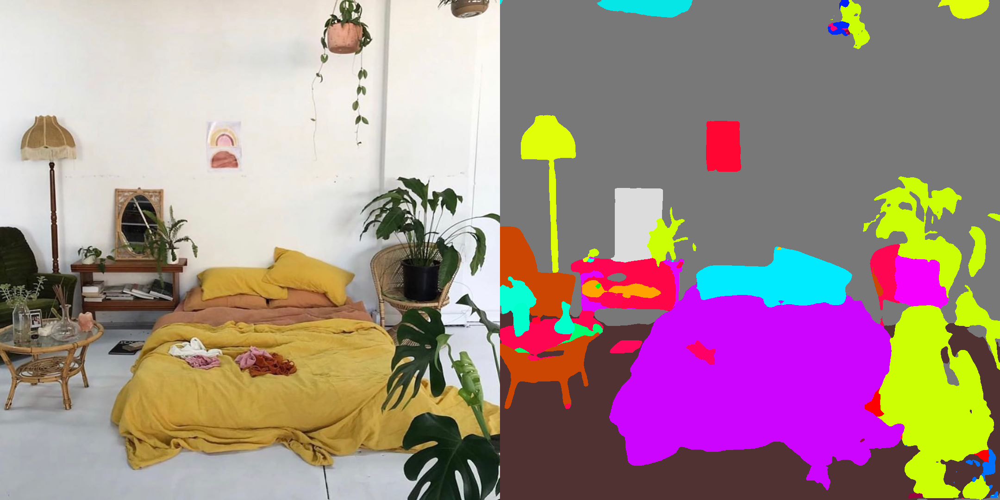

In [29]:
# Run the segmentation at the highest resolution.
with torch.no_grad():
    scores = segmentation_module(singleton_batch, segSize=output_size)
    
# Get the predicted scores for each pixel
_, pred = torch.max(scores, dim=1)
pred = pred.cpu()[0].numpy()
visualize_result(img_original, pred)

wall:


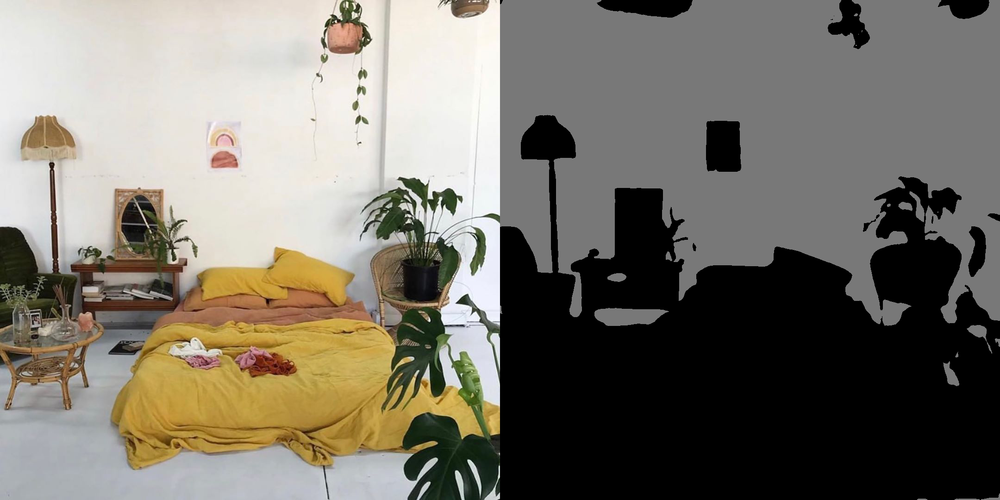

bed:


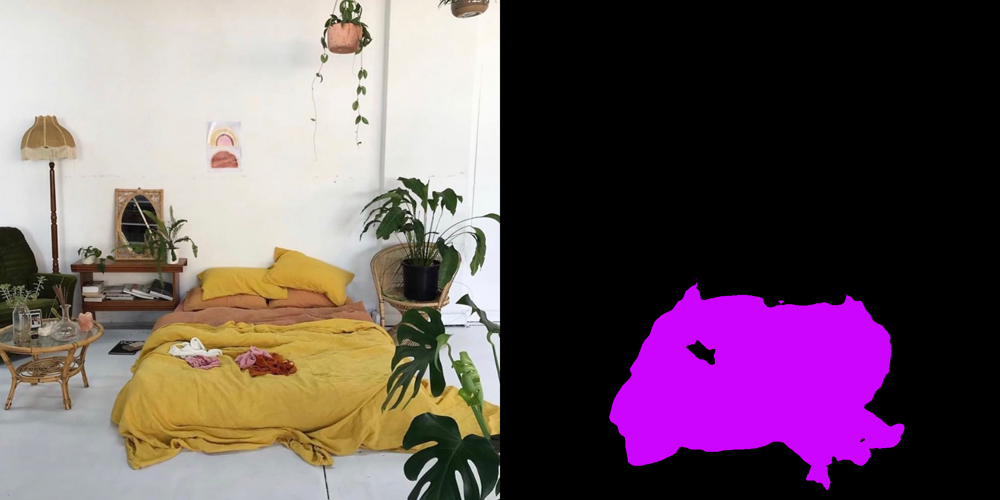

floor:


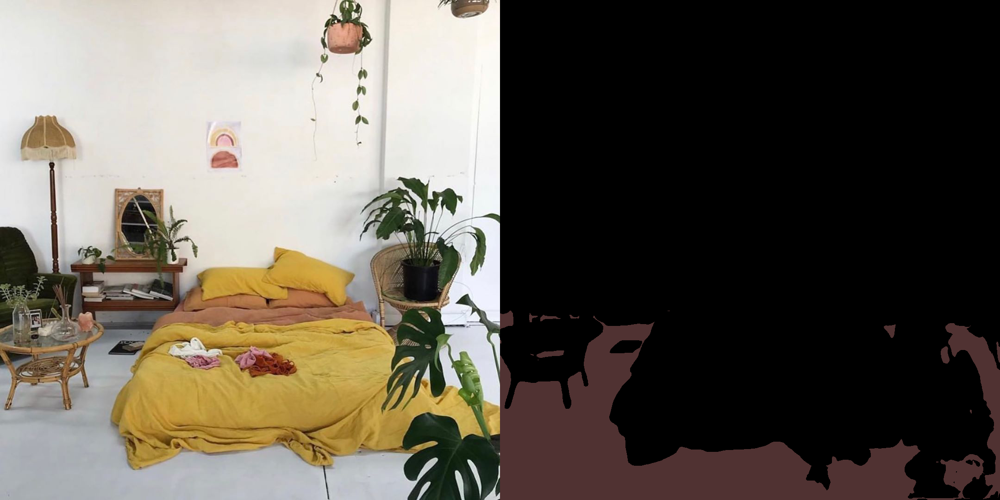

plant:


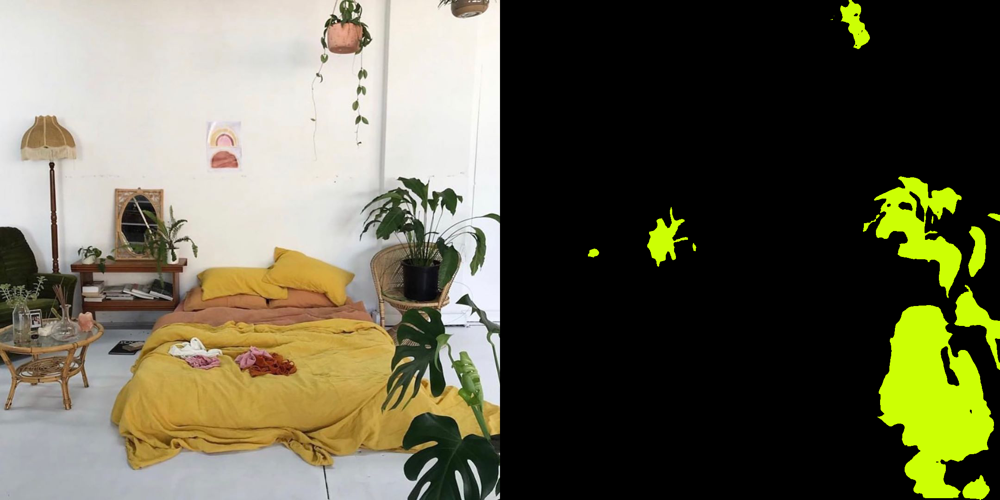

chair:


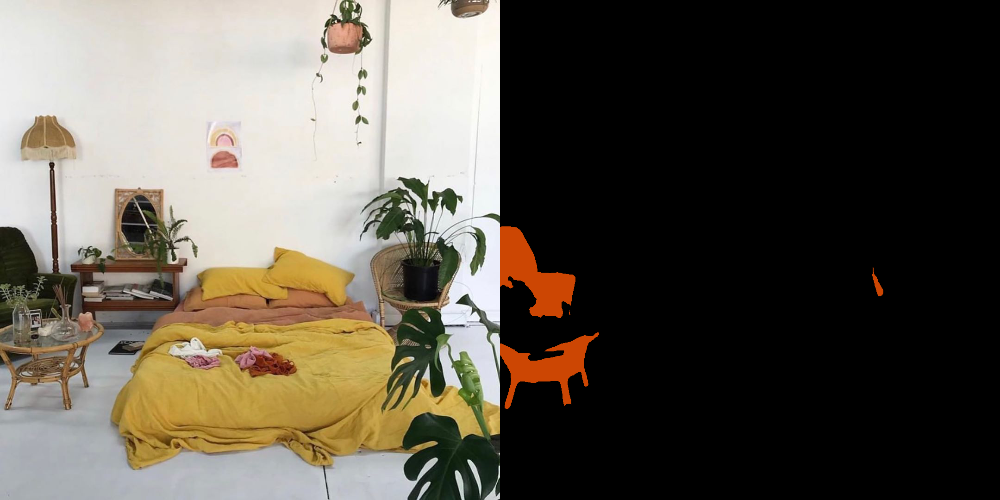

pillow:


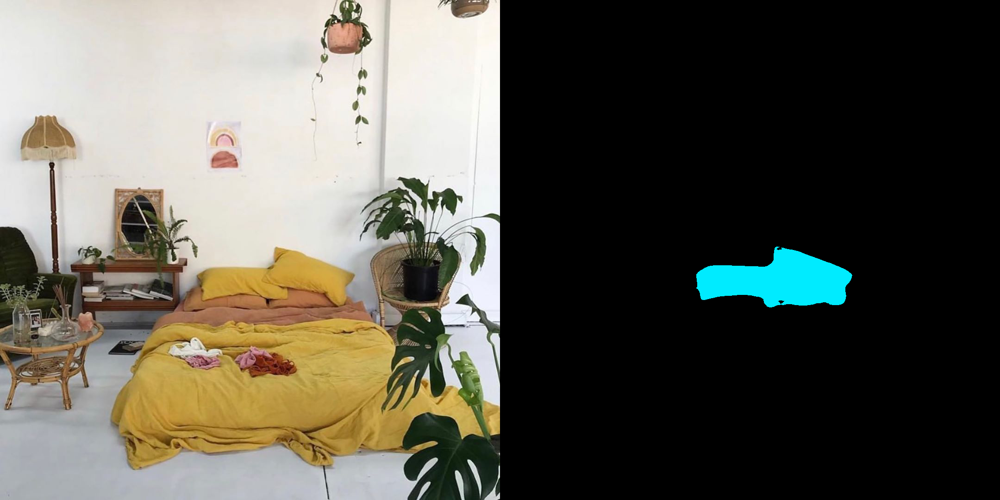

table:


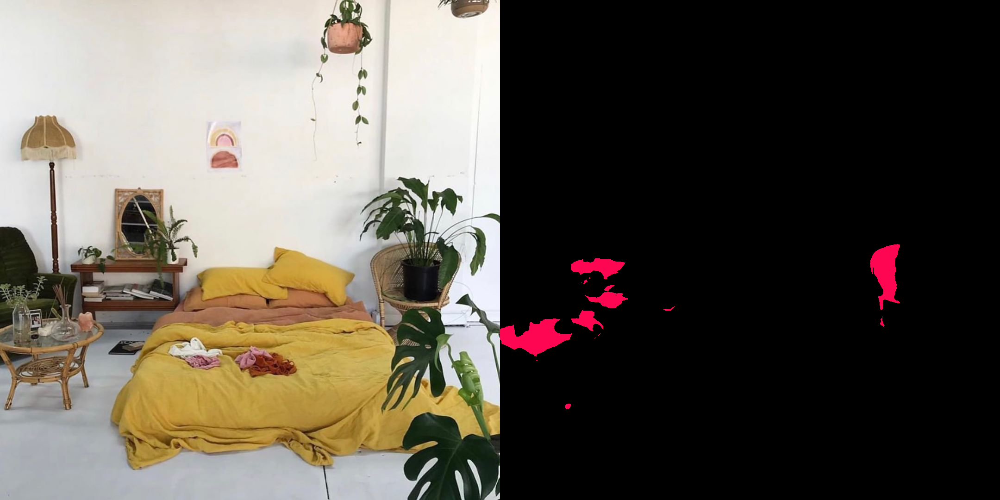

lamp:


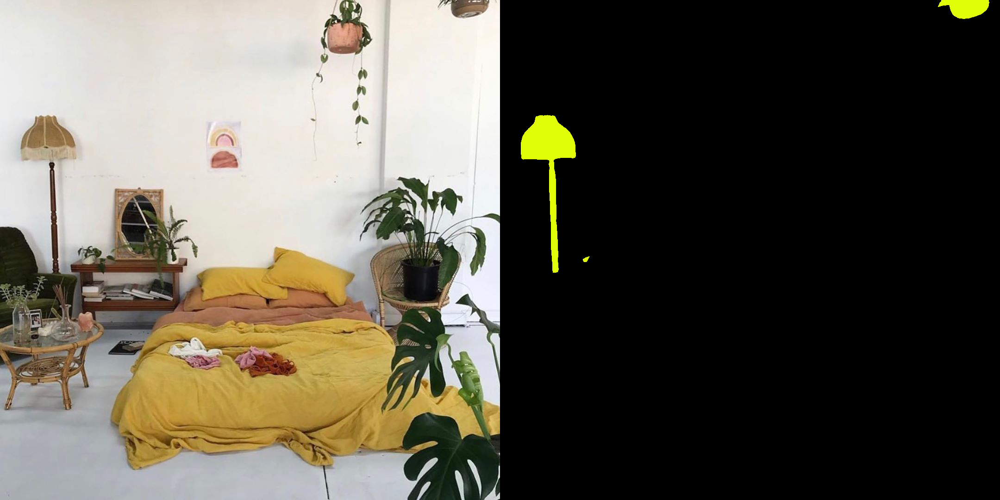

mirror:


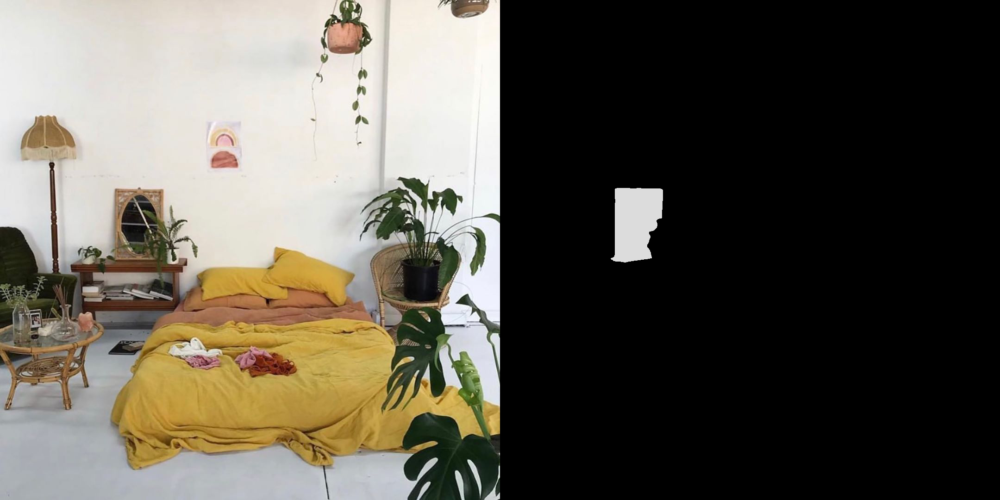

shelf:


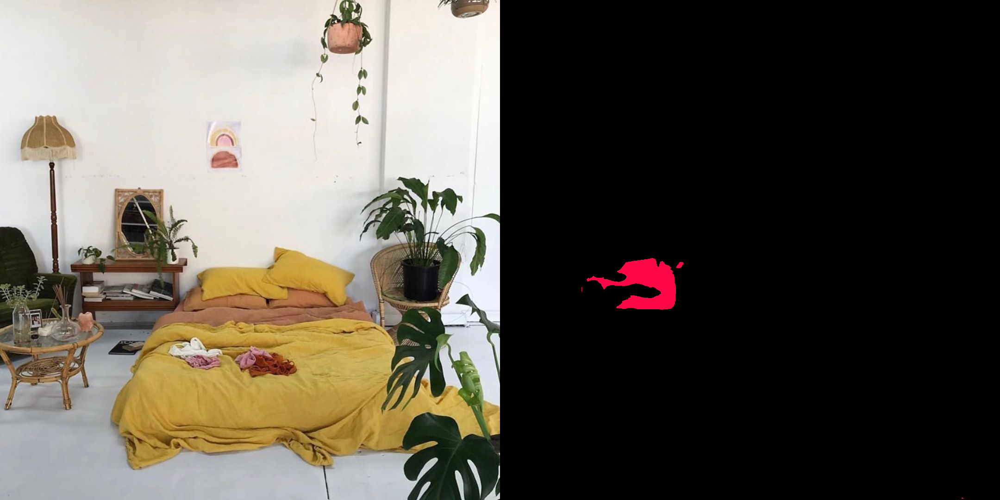

pot:


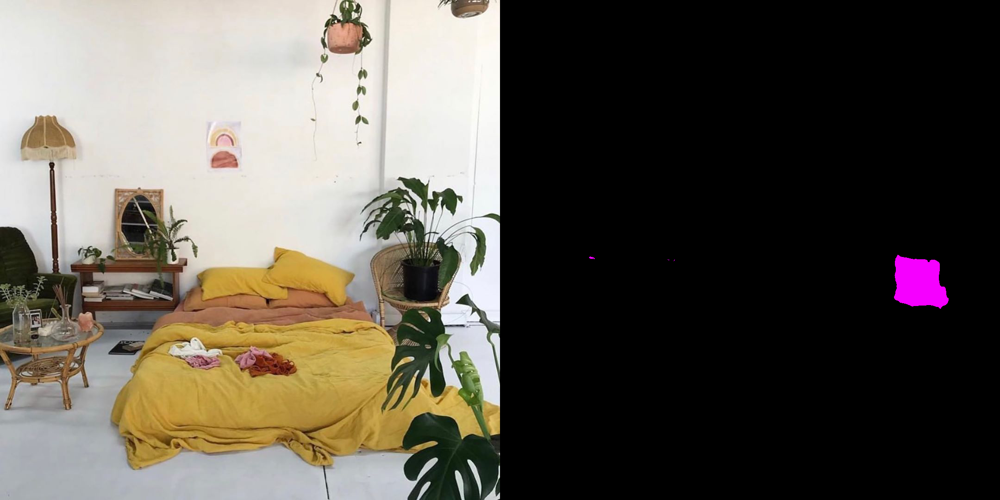

painting:


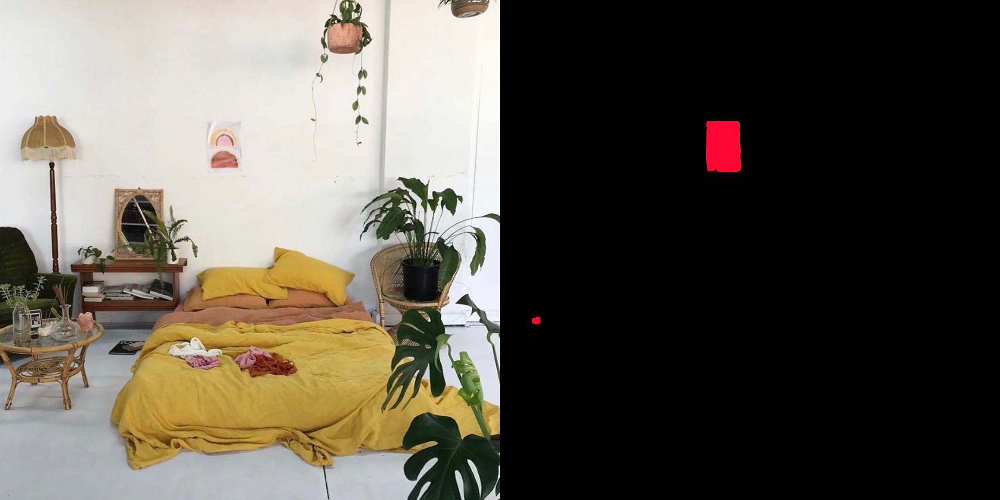

sky:


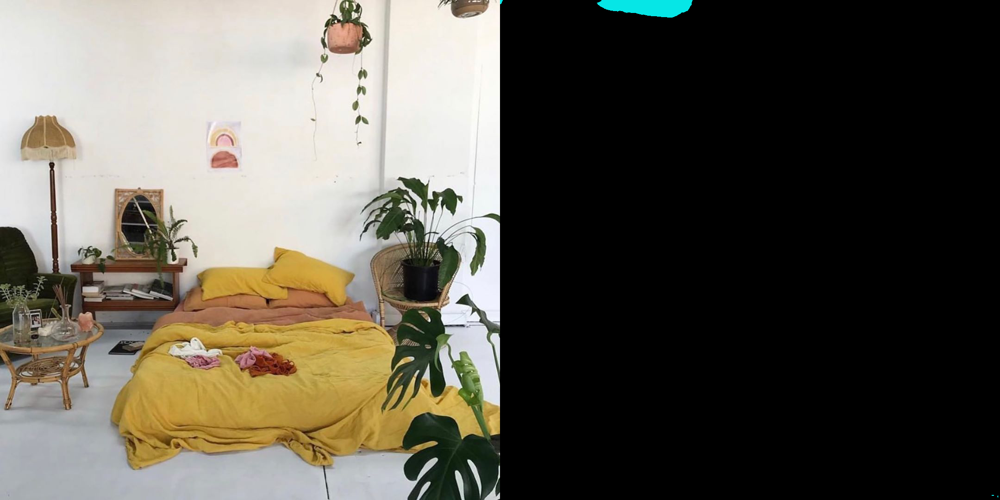

vase:


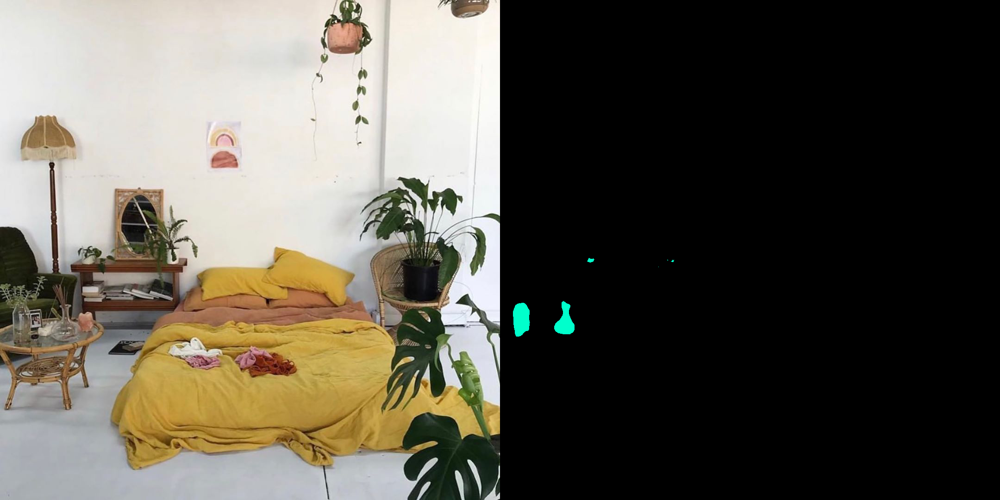

armchair:


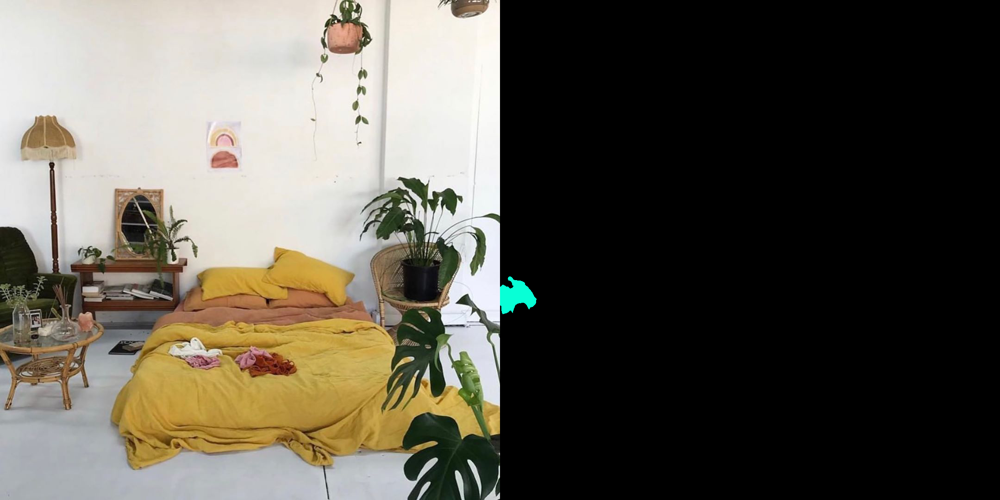

In [30]:
# Top classes in answer
predicted_classes = numpy.bincount(pred.flatten()).argsort()[::-1]
for c in predicted_classes[:15]:
    visualize_result(img_original, pred, c)

# Floor Only

floor:


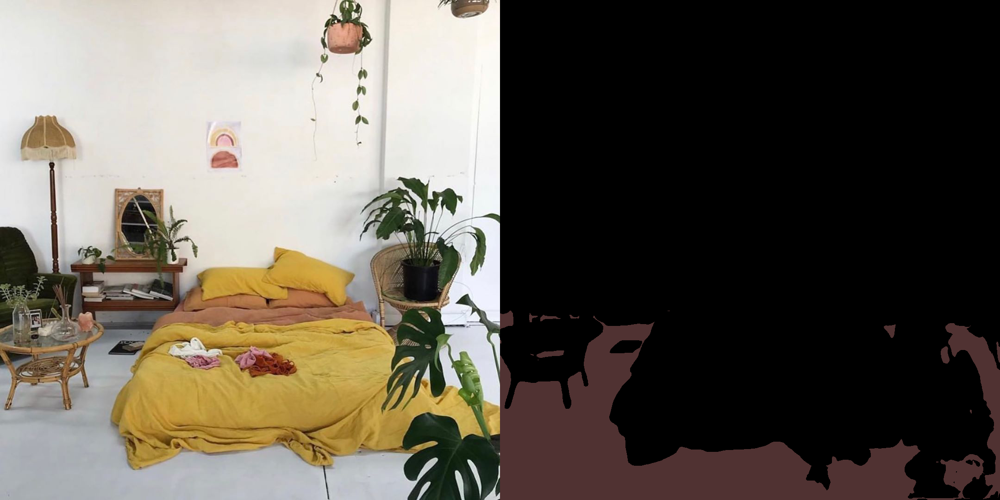

In [31]:
visualize_result(img_original, pred, 3)

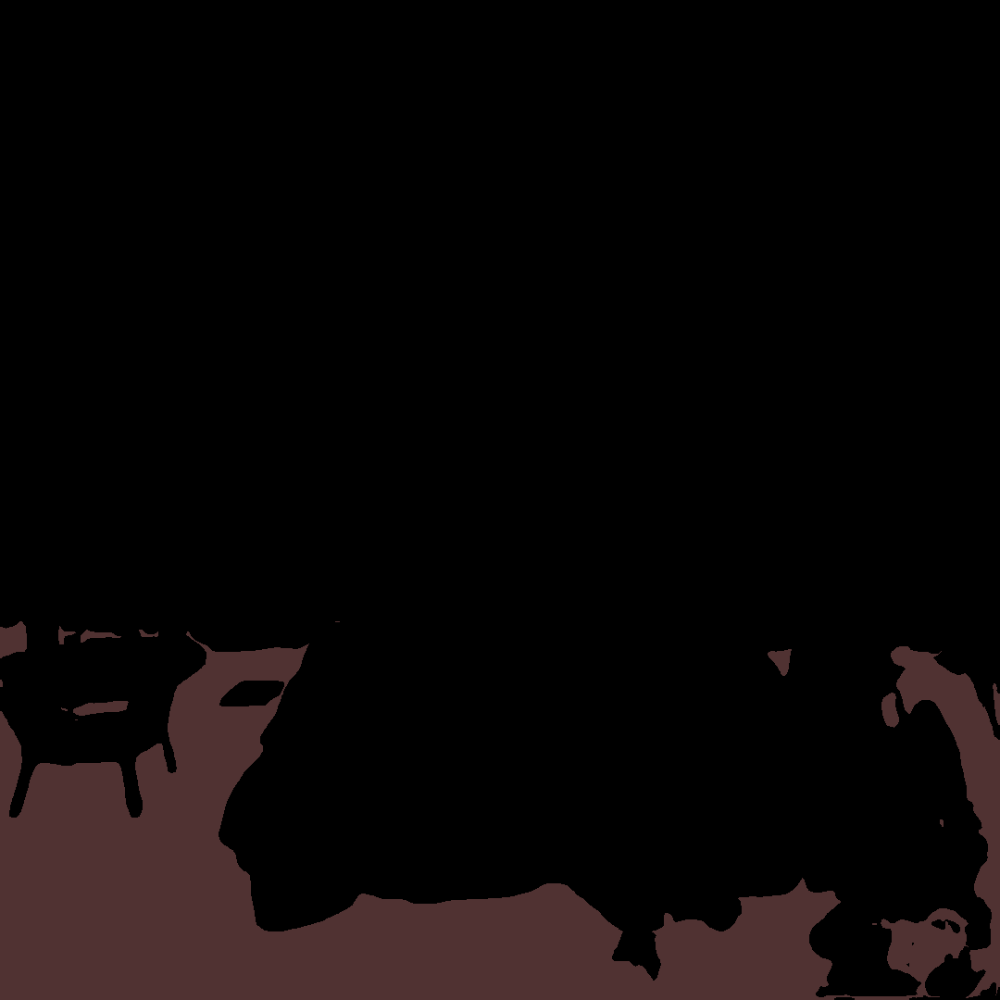

In [32]:
pred = pred.copy()
pred[pred != 3] = -1
pred_color = colorEncode(pred, colors).astype(numpy.uint8)

display(PIL.Image.fromarray(pred_color))

In [33]:
pred_color.shape

(1080, 1080, 3)

# Tile concat

In [34]:
import numpy as np
import cv2
# from google.colab.patches import cv2_imshow

In [ ]:
tile = cv2.imread('/content/REVER-TILES-encaustic-tile-COROLLA-022.1-four-tile-600px-80-500x500.jpg')
tile = cv2.resize(tile, (25, 25), interpolation = cv2.INTER_NEAREST)
t_h, t_w, _ = tile.shape

In [ ]:
f_h, f_w, _ = pred_color.shape
r_h, r_w = (f_h//t_h)+1, (f_w//t_w)+1

In [ ]:
cv2_imshow(tile)

In [ ]:
empt_floor = np.zeros(pred_color.shape, dtype=np.uint8)
filled_tiles = np.tile(tile, (r_h, r_w, 1))

#crop
filled_tiles = filled_tiles[0:f_h, 0:f_w, :]
cv2_imshow(filled_tiles)

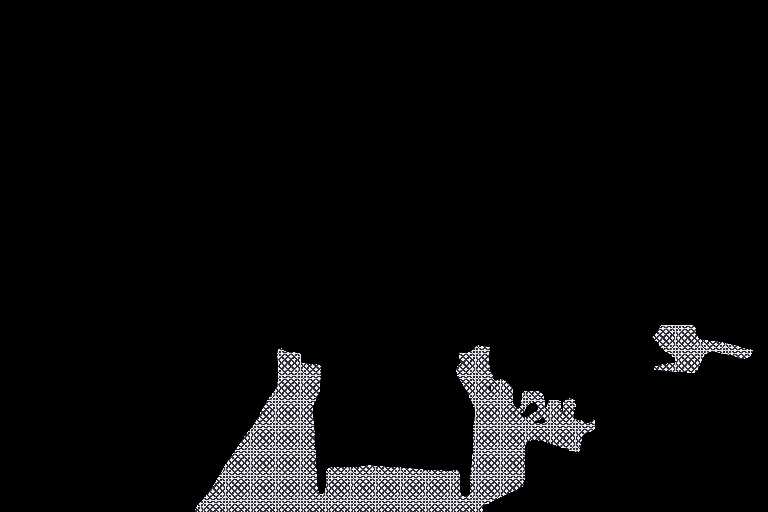

In [ ]:
#inv mask
mask = (cv2.cvtColor(pred_color, cv2.COLOR_RGB2GRAY) != 0).astype(np.uint8)
mask_inv = (mask==0).astype(np.uint8)

b, g, r = cv2.split(filled_tiles)

b = np.multiply(b, mask)
g = np.multiply(g, mask)
r = np.multiply(r, mask)

floor_masked = np.stack((b, g, r), axis=2)
cv2_imshow(floor_masked)

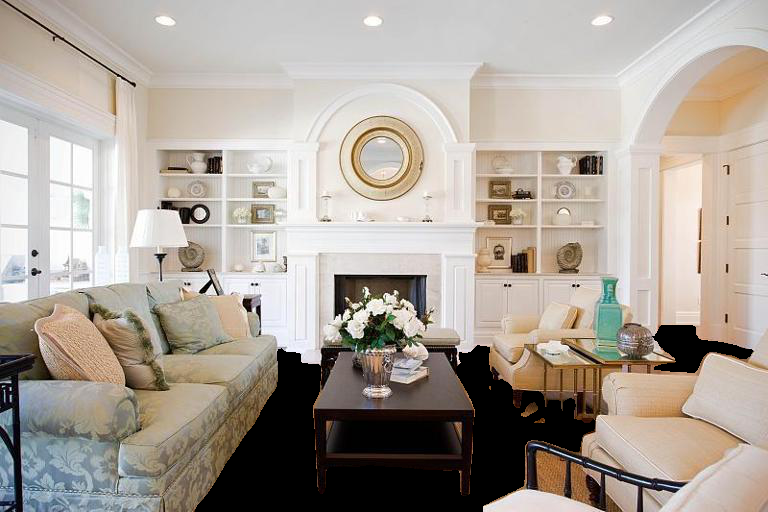

In [ ]:
r_, g_, b_ = cv2.split(img_original)

b_ = np.multiply(b_, mask_inv)
g_ = np.multiply(g_, mask_inv)
r_ = np.multiply(r_, mask_inv)

floor_inv_masked = np.stack((b_, g_, r_), axis=2)
cv2_imshow(floor_inv_masked)

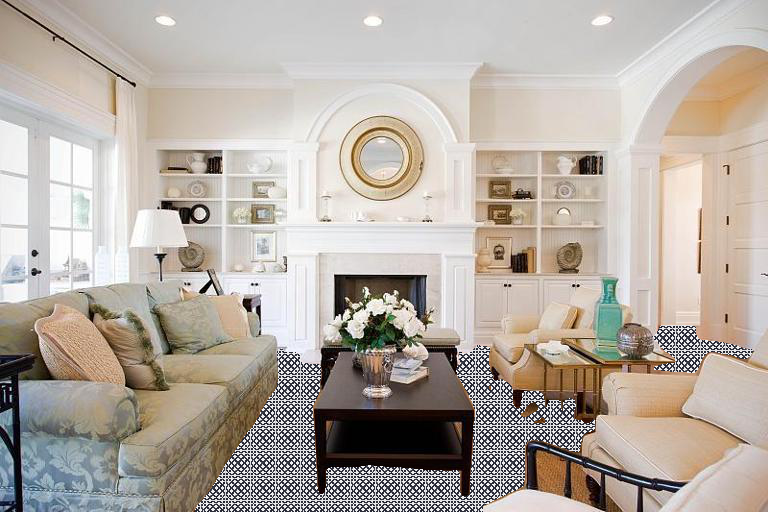

In [ ]:
mix = cv2.add(floor_inv_masked, floor_masked)
cv2_imshow(mix)